# <div align="center">**Sentinel image processing**</div>

In [1]:
import rasterio
import rasterio.plot as plot
from rasterio.plot import show
import os

In [2]:
path = os.path.abspath("")
path

'/home/jovyan/Sentinel/C-SCALE'

#### Locate the folder with the image data

In [3]:
img_folder = path + '/images/jp2/'
img_folder

'/home/jovyan/Sentinel/C-SCALE/images/jp2/'

In [4]:
img_name = "TCI.jp2"
tci = rasterio.open(img_folder + img_name, driver='JP2OpenJPEG');

#### We can show satellite image in the notebook, but be careful, it will take about 4 minutes to render!

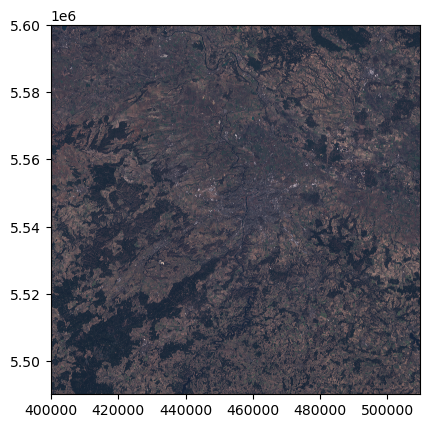

CPU times: user 6min 6s, sys: 1min 19s, total: 7min 25s
Wall time: 3min 52s


<AxesSubplot: >

In [5]:
%%time
# This takes quite a long time to execute
show(tci)

#### <div align="center">**Position of selected image in OpenStreet Maps**</div>

#### We can check whether we really downloaded satellite image data of our interest using OpenStreet maps.

In order to show we need to use some predefined functions to play a little bit with the metadata and coordinates of the satelite image.

In [5]:
import folium
from rasterio import warp
from use_functions import reverse_coordinates, to_index, generate_polygon, pol_to_np, pol_to_bounding_box

In [6]:
# original bounds of the image
bounds_trans_original = warp.transform_bounds(tci.crs,{'init': 'epsg:4326'},
                                              *tci.bounds)
polygon_trans_original = generate_polygon(bounds_trans_original)

polyline_polygon_trans_original = folium.PolyLine(reverse_coordinates(polygon_trans_original),
                                                  popup="polygon_trans_original",
                                                  color="green")#"#2ca02c")

In [7]:
mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0
map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)
map_bb.add_child(polyline_polygon_trans_original)
map_bb

#### We can now create our region of interest. Region of interested was created with [geojson.io](https://geojson.io).

In [8]:
import geojson

gejson_file = path + "/geojson/prague_map.geojson"

# Open geojson file with GPS coordinates
with open(gejson_file) as f:
    gj = geojson.load(f)

# Load coordinates from geojson file
coor = gj['features'][0]['geometry']['coordinates']

k = 0
cord = [[0] for i in range(len(coor[0]))]
for i in range(len(coor)):
    for j in range(len(coor[0])):
        cord[k] = coor[i][j]
        k += 1

In [9]:
polyline_pol_clip = folium.PolyLine(reverse_coordinates(cord), popup="cord",color="red")

In [10]:
mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0
map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)
map_bb.add_child(polyline_polygon_trans_original)
map_bb.add_child(polyline_pol_clip)
map_bb

#### We can also show the region of interest within the satelite image, but we need to convert the coordinates using some predefined functions

In [11]:
from bbox_converter import bbox_converter
geo_bbox = path + "/geojson/bbox_map_convert.geojson"
bbox_converter(gejson_file,geo_bbox,32633)

The file /home/jovyan/Sentinel/C-SCALE/geojson/bbox_map_convert.geojson has been saved!


In [12]:
import geopandas as gpd
gdf = gpd.read_file(geo_bbox)

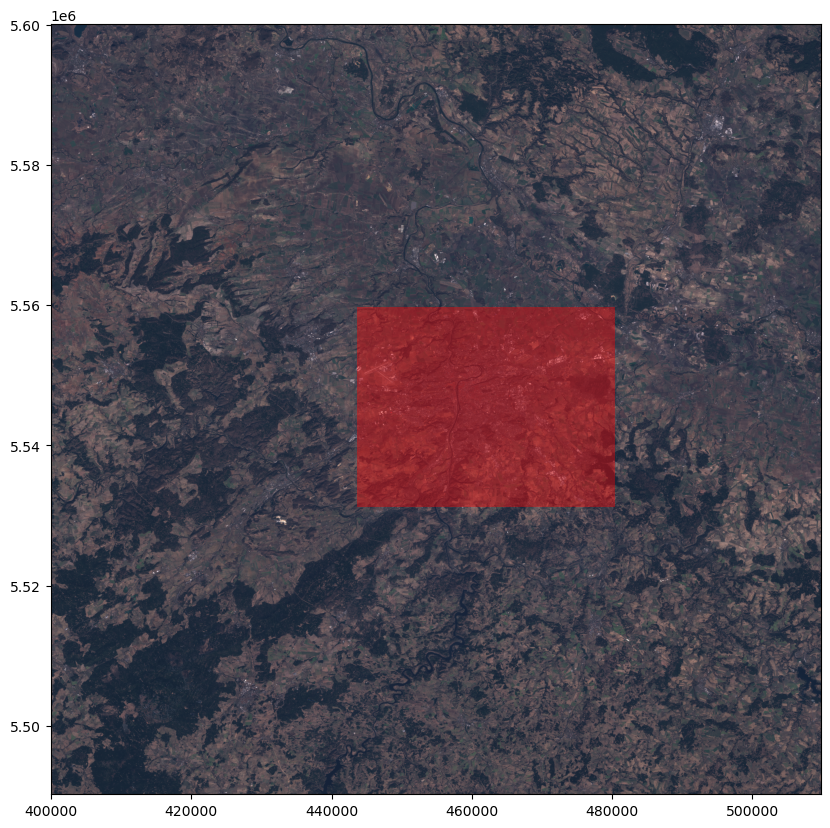

CPU times: user 6min 12s, sys: 1min 21s, total: 7min 33s
Wall time: 4min 2s


In [13]:
%%time
import matplotlib.pyplot as plt

# This takes quite a long time to execute
fig, ax = plt.subplots(figsize=(12, 10))
show(tci,ax=ax)
gdf.plot(ax=ax, color='red', alpha=.4, aspect=1)
plt.show()

### <div align="center">**Insert clipped Sentinel image in OpenStreet Map**</div>

In [14]:
import pyproj
import numpy as np
import json
import rasterio
from rasterio.plot import show
from rasterio import windows
from matplotlib import pyplot as plt
from image_clip import clipper
import os

In [15]:
# Choose folder for clipped images
path_folder = path + "/images/clipped/"

In [16]:
if os.path.isdir(path_folder) != True:
    os.mkdir(path_folder)
clipper(img_folder,geo_bbox,path_folder)

All clipped images are saved in /home/jovyan/Sentinel/C-SCALE/images/clipped/ folder!


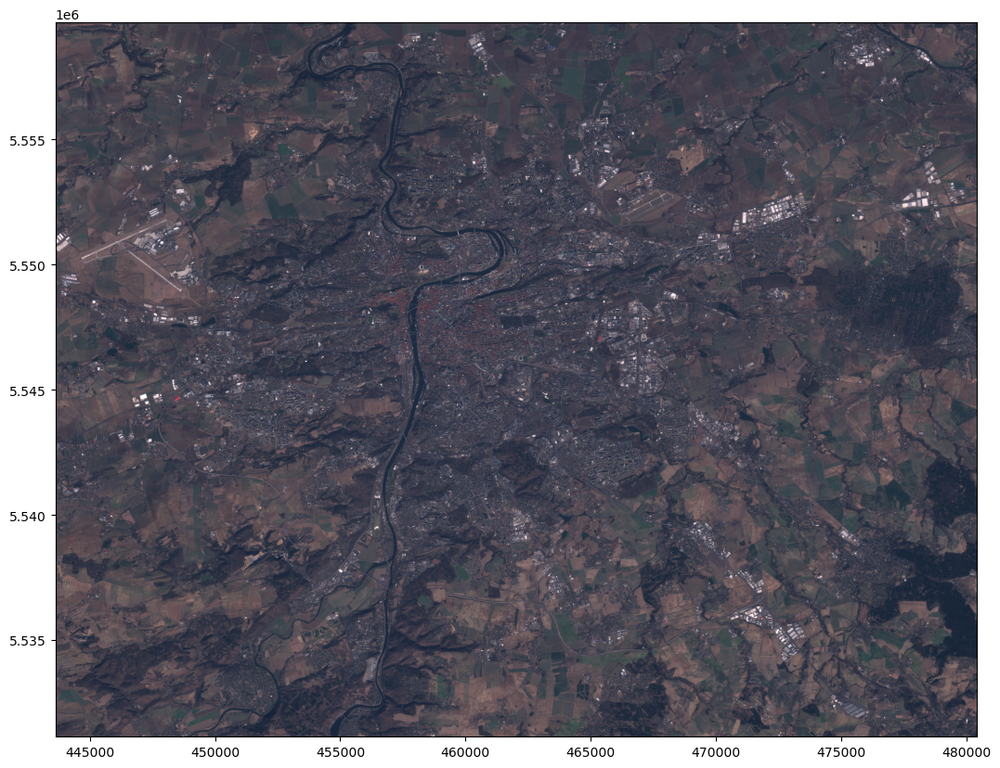

<AxesSubplot: >

In [17]:
clip = path_folder + "TCI.tif"
plt.figure(figsize=(15,10))
clipped_img = rasterio.open(clip)
show(clipped_img)

In [23]:
# Read img and convert to numpy stack
img = np.stack([clipped_img.read(i) for i in range(1,4)], axis=-1)

In [24]:
bbox = pol_to_bounding_box(cord)
bounds_trans = warp.transform_bounds({'init': 'epsg:4326'},clipped_img.crs,*bbox)
pol_bounds_trans = generate_polygon(bounds_trans)

bbox = pol_to_bounding_box(pol_bounds_trans)
window_same = windows.from_bounds(*bbox,clipped_img.transform)
transform_window = windows.transform(window_same,clipped_img.transform)

In [25]:
transform,width,height = warp.calculate_default_transform(clipped_img.crs, {"init":"epsg:4326"},
                                                          img.shape[1],img.shape[0],
                                                          left=bbox[0],bottom=bbox[1],
                                                          right=bbox[2],top=bbox[3])
                                                          #resolution=0.002)

out_array = np.ndarray((img.shape[2],height,width),dtype=img.dtype)

In [26]:
warp.reproject(np.transpose(img,axes=(2,0,1)),
               out_array,
               src_crs=clipped_img.crs,
               dst_crs={"init":"epsg:4326"},
               src_transform=transform_window,
               dst_transform=transform,
               resampling=warp.Resampling.bilinear);

#plt.figure(figsize=(8,8))
#plot.show(out_array, transform=transform)


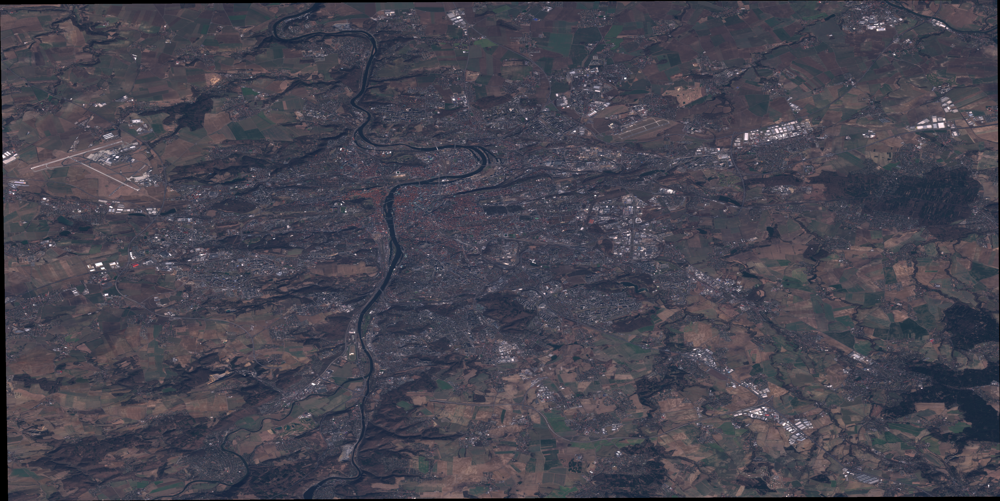

In [27]:
bbox_clip = pol_to_bounding_box(cord)

mean_lat = (bounds_trans_original[1] + bounds_trans_original[3]) / 2.0
mean_lng = (bounds_trans_original[0] + bounds_trans_original[2]) / 2.0

map_bb = folium.Map(location=[mean_lat-0.2,mean_lng+1.5], zoom_start=8)

map_bb.add_child(polyline_polygon_trans_original)
map_bb.add_child(polyline_pol_clip)
image_overlay = folium.raster_layers.ImageOverlay(np.transpose(out_array,(1,2,0)),
                                                  [[bbox_clip[1],
                                                    bbox_clip[0]],
                                                   [bbox_clip[3],
                                                    bbox_clip[2]]])
map_bb.add_child(image_overlay)
map_bb